In [ ]:
%matplotlib inline
import tensorflow as tf
import PIL
import os
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
from google.colab import files
import time
import matplotlib.pyplot as plt
from tqdm import tqdm
import cv2
from IPython import display
print('Tensorflow version:', tf.__version__)

Tensorflow version: 2.5.0


In [ ]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 6861535172117955887
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 14509932544
locality {
  bus_id: 1
  links {
  }
}
incarnation: 4478028184205295873
physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
]


In [ ]:
!gdown --id 1iT34DEX3ngx7JxOsxtWFOzeVvh2Fgt2d

Downloading...
From: https://drive.google.com/uc?id=1iT34DEX3ngx7JxOsxtWFOzeVvh2Fgt2d
To: /content/ships_optical.zip
781MB [00:10, 71.1MB/s]


In [ ]:
!gdown --id 13xLggEmn2gPb2P9iigu__eJBAhsq5lds

Downloading...
From: https://drive.google.com/uc?id=13xLggEmn2gPb2P9iigu__eJBAhsq5lds
To: /content/SAR-Ship-Dataset.zip
1.04GB [00:21, 47.4MB/s]


In [ ]:
!unzip ships_optical.zip
!unzip SAR-Ship-Dataset.zip
# !unzip optical_images.zip
# !unzip Sar_images.zip

Streaming output truncated to the last 5000 lines.
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801039011.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801039012.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801039038.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801039039.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801039043.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801039044.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801040038.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801040039.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801040043.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_02017071801040044.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_0201707180104025.jpg  
  inflating: SAR-Ship-Dataset/JPEGImages/Sen_ship_hv_0201707180104026.jpg  
  inflating: SAR-Ship-Datas

In [ ]:
size = len(os.listdir('optical'))
sar_size = len(os.listdir('SAR-Ship-Dataset/JPEGImages'))

In [ ]:
print(size,sar_size)

2368 43819


In [ ]:
batch_size = 20
img_height = 256
img_width = 256
num_classes = 8
channels = 3
num_features = 100

img_shape = (img_height, img_width, channels)
train_optical = tf.keras.preprocessing.image_dataset_from_directory("optical",
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               subset = 'training',
                                                               validation_split = 1 - 499.98/size,
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)
train_sar = tf.keras.preprocessing.image_dataset_from_directory("SAR-Ship-Dataset/JPEGImages",
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               subset = 'training',
                                                               validation_split = 1 - 500/sar_size,
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)
test_optical = tf.keras.preprocessing.image_dataset_from_directory("optical",
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               subset = 'validation',
                                                               validation_split = 1 - 500/size,
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)
test_sar = tf.keras.preprocessing.image_dataset_from_directory("SAR-Ship-Dataset/JPEGImages",
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               subset = 'validation',
                                                               validation_split = 1 - 500/sar_size,
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)

Found 2368 files belonging to 1 classes.
Using 500 files for training.


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


Found 43819 files belonging to 1 classes.
Using 500 files for training.
Found 2368 files belonging to 1 classes.
Using 1868 files for validation.
Found 43819 files belonging to 1 classes.
Using 43319 files for validation.


In [ ]:
def random_crop(image):
  if image.shape[0]== None:
    s = batch_size
  else:
    s = image.shape[0]
  cropped_image = tf.image.random_crop(
      image, size=[s,img_height, img_width, 3])

  return cropped_image


In [ ]:
def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

In [ ]:
@tf.function()
def random_jitter(image):
  image = tf.image.resize(image, [286, 286],
                          method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  image = random_crop(image)
  image = tf.image.random_flip_left_right(image)
  return image

In [ ]:
def preprocess_image_train(image):
  image = random_jitter(image)
  image = normalize(image)
  return image

In [ ]:
def preprocess_image_test(image):
  image = normalize(image)
  return image

In [ ]:
train_optical = train_optical.cache().map(
    preprocess_image_train, num_parallel_calls=tf.data.AUTOTUNE)

train_sar = train_sar.cache().map(
    preprocess_image_train, num_parallel_calls=tf.data.AUTOTUNE)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/data/ops/dataset_ops.py:3704: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable.debug_mode()`.
  "Even though the `tf.config.experimental_run_functions_eagerly` "


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


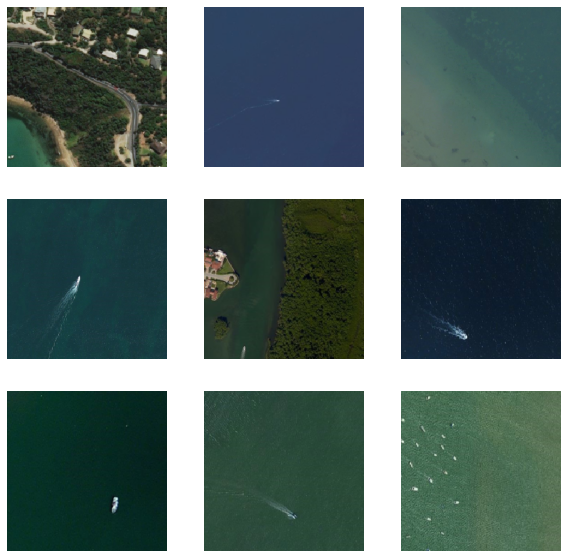

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
for images in train_optical.take(2):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i] * 0.5 + 0.5)
    plt.title('')
    plt.axis("off")

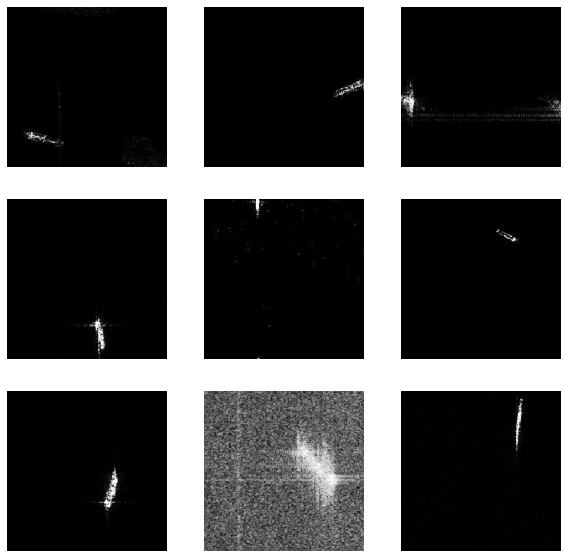

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
for images in train_sar.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(((images[i] * 0.5 + 0.5)))
    plt.title('')
    plt.axis("off")

In [ ]:
OUTPUT_CHANNELS = 3
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [ ]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),
    downsample(128, 4),
    downsample(256, 4),
    downsample(512, 4),
    downsample(512, 4),
    downsample(512, 4),
    downsample(512, 4),
    downsample(512, 4),
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),
    upsample(512, 4, apply_dropout=True),
    upsample(512, 4, apply_dropout=True),
    upsample(512, 4),
    upsample(256, 4),
    upsample(128, 4),
    upsample(64, 4),
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')

  x = inputs

  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

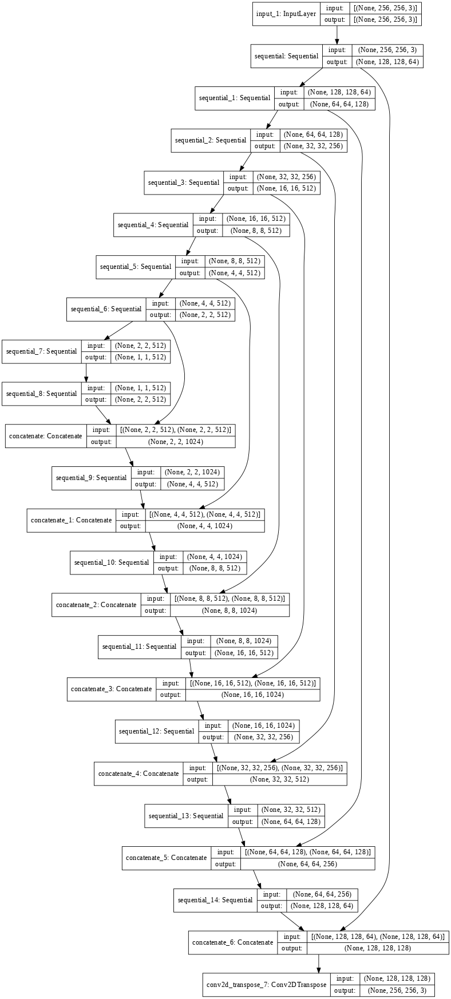

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  x = inp
  down1 = downsample(64, 4, False)(x)
  down2 = downsample(128, 4)(down1)
  down3 = downsample(256, 4)(down2)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)

  return tf.keras.Model(inputs=inp, outputs=last)


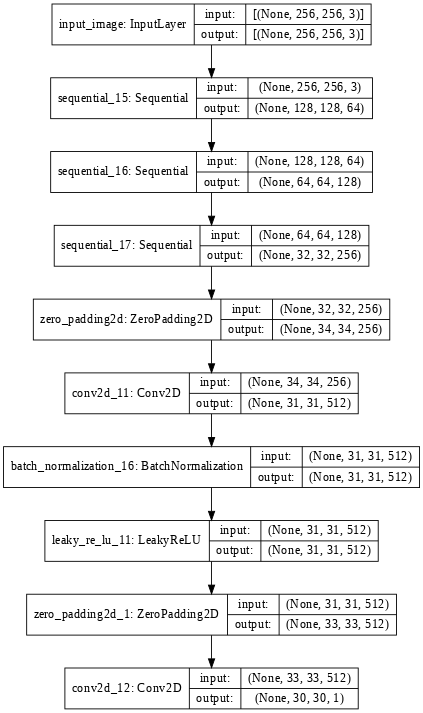

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)


In [ ]:
generator_g = Generator()
generator_f = Generator()

discriminator_x = Discriminator()
discriminator_y = Discriminator()


In [ ]:
sample_optical = list(train_optical.take(1).as_numpy_iterator())[0][7]
sample_sar = list(train_sar.take(3).as_numpy_iterator())[0][1]

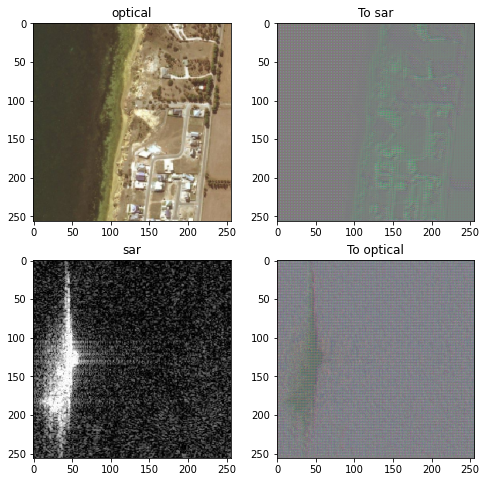

In [ ]:
to_sar = generator_g(tf.reshape(sample_optical,[1,256,256,3]),training=False)
to_optical = generator_f(tf.reshape(sample_sar,[1,256,256,3]),training=False)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_optical, to_sar, sample_sar, to_optical]
title = ['optical', 'To sar', 'sar', 'To optical']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i] * 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()


In [ ]:
sample_optical = tf.reshape(sample_optical,[1,256,256,3])
sample_sar = tf.reshape(sample_sar,[1,256,256,3])

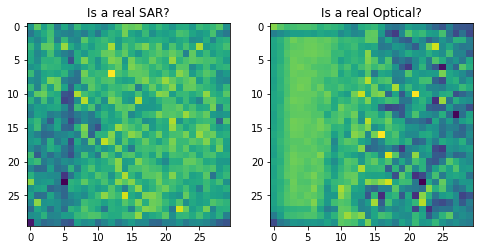

In [ ]:
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is a real SAR?')
plt.imshow(discriminator_y(sample_sar)[0, ..., -1])

plt.subplot(122)
plt.title('Is a real Optical?')
plt.imshow(discriminator_x(sample_optical)[0, ..., -1])

plt.show()


In [ ]:
LAMBDA = 10
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)


In [ ]:
def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)

  generated_loss = loss_obj(tf.zeros_like(generated), generated)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss * 0.5

In [ ]:
def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)


In [ ]:
def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))

  return LAMBDA * loss1

In [ ]:
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

In [ ]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
# !gdown --id 1Hl8YiKWsd_W6sYEucDd2Anb7O1LPFksd

In [ ]:
# !unzip training_checkpoints_2k_10.zip

In [ ]:
checkpoint_path = "/content/training_checkpoints"
checkpoint_prefix = os.path.join(checkpoint_path, "ckpt")
ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)
check_epoch = 0
if ckpt_manager.latest_checkpoint:
  ckpt.restore(ckpt_manager.latest_checkpoint)
  check_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])*5
  print ('Latest checkpoint restored!! starting from epoch ',check_epoch)

In [ ]:
EPOCHS = 100-check_epoch
gen_losses_g = []
disc_losses_g = []
gen_losses_f = []
disc_losses_f = []
tf.config.run_functions_eagerly(True)

In [ ]:
def generate_images(model, test_input,n=0):
  prediction = model(test_input)

  plt.figure(figsize=(12, 12))

  display_list = [test_input[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  if n!=0:
    plt.savefig('predictions'+str(n))
  plt.show()

In [ ]:
@tf.function
def train_step(real_x, real_y):
  # persistent is set to True because the tape is used more than
  # once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator F translates Y -> X.

    fake_y = generator_g(real_x, training=True)
    cycled_x = generator_f(fake_y, training=True)

    fake_x = generator_f(real_y, training=True)
    cycled_y = generator_g(fake_x, training=True)

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True)
    same_y = generator_g(real_y, training=True)

    disc_real_x = discriminator_x(real_x, training=True)
    disc_real_y = discriminator_y(real_y, training=True)

    disc_fake_x = discriminator_x(fake_x, training=True)
    disc_fake_y = discriminator_y(fake_y, training=True)

    # calculate the loss
    gen_g_loss = generator_loss(disc_fake_y)
    gen_f_loss = generator_loss(disc_fake_x)

    total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

    # Total generator loss = adversarial loss + cycle loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    gen_losses_g.append(total_gen_g_loss.numpy().mean())
    gen_losses_f.append(total_gen_f_loss.numpy().mean())

    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    disc_losses_g.append(disc_y_loss.numpy().mean())
    disc_losses_f.append(disc_x_loss.numpy().mean())

  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, 
                                        generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, 
                                        generator_f.trainable_variables)

  discriminator_x_gradients = tape.gradient(disc_x_loss, 
                                            discriminator_x.trainable_variables)
  discriminator_y_gradients = tape.gradient(disc_y_loss, 
                                            discriminator_y.trainable_variables)

  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients, 
                                            generator_g.trainable_variables))

  generator_f_optimizer.apply_gradients(zip(generator_f_gradients, 
                                            generator_f.trainable_variables))

  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,
                                                discriminator_x.trainable_variables))

  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,
                                                discriminator_y.trainable_variables))


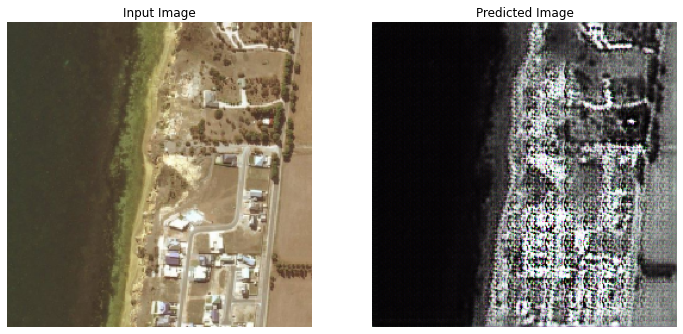

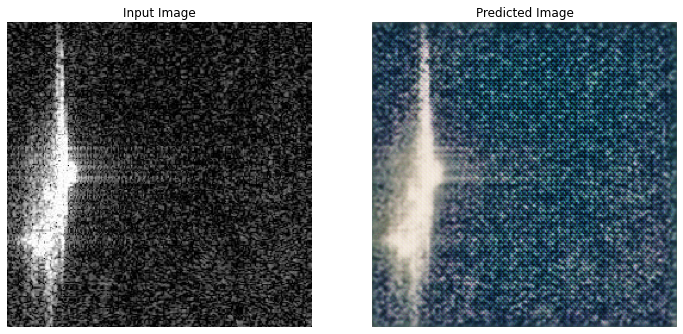

Saving checkpoint for epoch 25 at /content/training_checkpoints/ckpt-5
Time taken for epoch 25 is 110.00346541404724 sec



KeyboardInterrupt: ignored

In [ ]:
for epoch in range(EPOCHS):
  start = time.time()

  n = 0
  for image_x, image_y in tf.data.Dataset.zip((train_optical, train_sar)):
    train_step(image_x, image_y)
    if n % 10 == 0:
      print ('.', end='')
    n += 1

  display.clear_output(wait=True)
  generate_images(generator_g, sample_optical)
  generate_images(generator_f, sample_sar)

  if (epoch + 1) % 5 == 0:
    ckpt_save_path = ckpt_manager.save()
    print ('Saving checkpoint for epoch {} at {}'.format(epoch+check_epoch+1,
                                                         ckpt_save_path))

  print ('Time taken for epoch {} is {} sec\n'.format(epoch+check_epoch + 1,
                                                      time.time()-start))

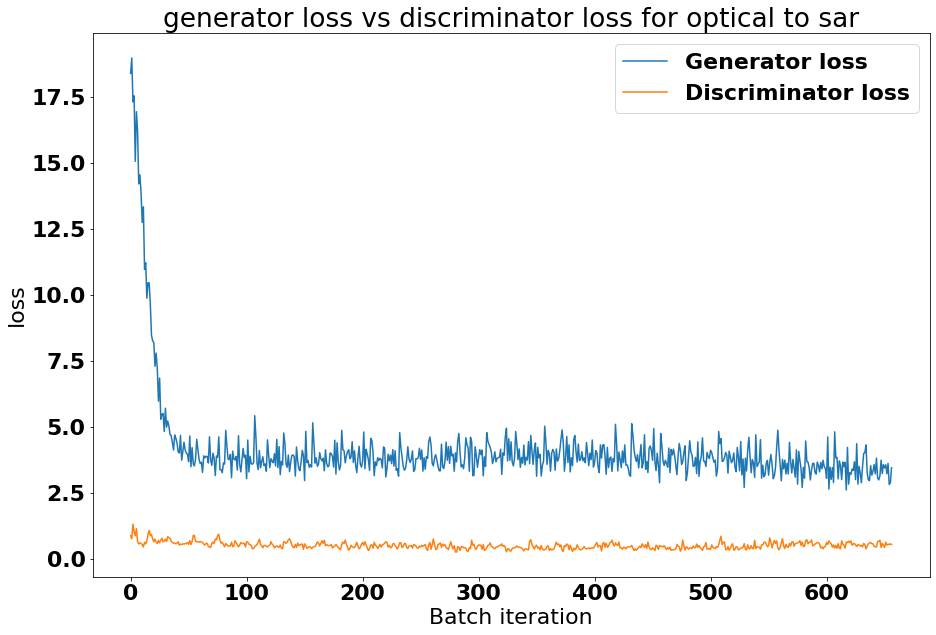

In [ ]:
import matplotlib
font = {'weight' : 'bold',
        'size'   : 22}
matplotlib.rc('font', **font)
fig = plt.figure(figsize=(15, 10))
plt.plot(gen_losses_g,label='Generator loss')
plt.plot(disc_losses_g,label='Discriminator loss')
plt.title('generator loss vs discriminator loss for optical to sar')
plt.xlabel('Batch iteration')
plt.ylabel('loss')
plt.legend()
plt.savefig('losses_optical_to_sar.png')

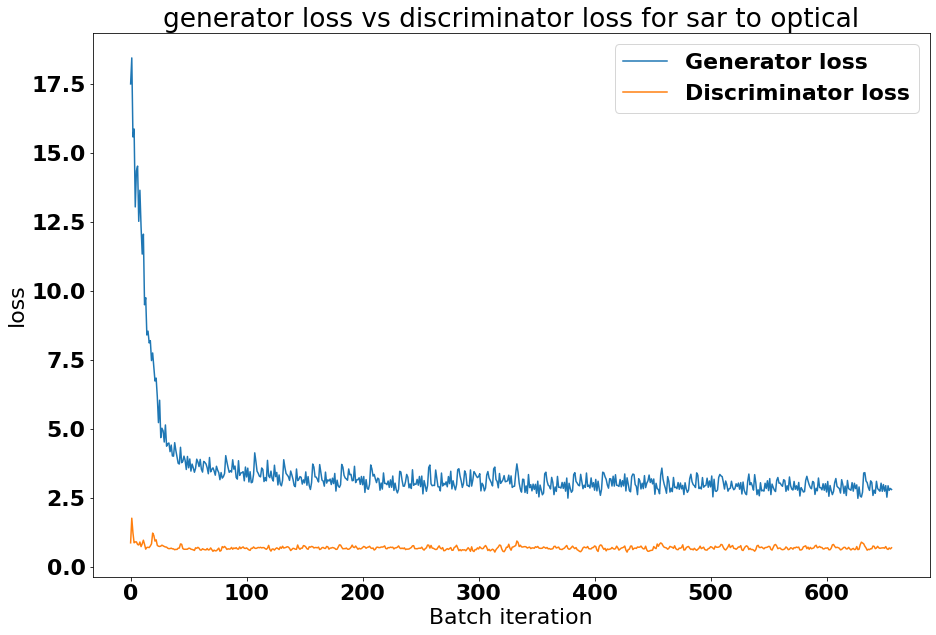

In [ ]:
fig = plt.figure(figsize=(15, 10))
plt.plot(gen_losses_f,label='Generator loss')
plt.plot(disc_losses_f,label='Discriminator loss')
plt.title('generator loss vs discriminator loss for sar to optical')
plt.xlabel('Batch iteration')
plt.ylabel('loss')
plt.legend()
plt.savefig('losses_sar_to_optical.png')

In [ ]:
# keras.models.save_model(generator_g,'drive/MyDrive/optical_to_sar_100.h5')
# keras.models.save_model(generator_f,'drive/MyDrive/sar_to_optical_100.h5')

In [ ]:
# !zip -r drive/MyDrive/training_checkpoints_2k_10.zip training_checkpoints

updating: training_checkpoints/ (stored 0%)
updating: training_checkpoints/checkpoint (deflated 70%)
updating: training_checkpoints/ckpt-1.index (deflated 81%)
updating: training_checkpoints/ckpt-1.data-00000-of-00001 (deflated 15%)
updating: training_checkpoints/ckpt-2.index (deflated 81%)
updating: training_checkpoints/ckpt-2.data-00000-of-00001 (deflated 15%)
updating: training_checkpoints/ckpt-4.index (deflated 81%)
updating: training_checkpoints/ckpt-4.data-00000-of-00001 (deflated 15%)
updating: training_checkpoints/ckpt-5.index (deflated 81%)
updating: training_checkpoints/ckpt-5.data-00000-of-00001 (deflated 15%)
updating: training_checkpoints/ckpt-3.index (deflated 81%)
updating: training_checkpoints/ckpt-3.data-00000-of-00001 (deflated 15%)
updating: training_checkpoints/ckpt-8.index (deflated 81%)
updating: training_checkpoints/ckpt-6.index (deflated 81%)
updating: training_checkpoints/ckpt-8.data-00000-of-00001 (deflated 15%)
updating: training_checkpoints/ckpt-6.data-00000

In [ ]:
!gdown --id 17jGY-llIXkWBNkcF76PI8BRDkzWy7hMX

Downloading...
From: https://drive.google.com/uc?id=17jGY-llIXkWBNkcF76PI8BRDkzWy7hMX
To: /content/refineries.zip
7.65MB [00:00, 64.2MB/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip refineries.zip

Archive:  refineries.zip
   creating: refineries/
  inflating: refineries/2088218176_a77ee6942e_b.jpg  
  inflating: refineries/2266.jpg     
  inflating: refineries/30_centimeter_satellite_imagery_SAU_Ras_Tanura_Refinery-757x418.jpg  
  inflating: refineries/5663051359_de4155e087_o.jpg  
  inflating: refineries/BirdiImage_lat_-29.550572_lng_30.449955_Z18_01Jun2018_0828UTC-1024x1024.jpg  
  inflating: refineries/deer-park-refin_400px-310px-tn.jpg  
  inflating: refineries/Houston_Texas_30cmaerial_9_21_to_9_23_2014_II-300x225.jpg  
  inflating: refineries/images.jpg   
  inflating: refineries/images1.jpg  
  inflating: refineries/images2.jpg  
  inflating: refineries/images3.jpg  
  inflating: refineries/images4.jpg  
  inflating: refineries/images5.jpg  
  inflating: refineries/modular-oil-refinery.jpg  
refineries/Ras Tanura Refinery, Saudi Arabia. WorldView-3 satellite ©DigitalGlobe.jpg:  mismatching "local" filename (refineries/Ras Tanura Refinery, Saudi Arabia. WorldView-3 satellit

In [ ]:
test = tf.keras.preprocessing.image_dataset_from_directory("refineries",
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               subset = 'validation',
                                                               validation_split = 1 - 20/sar_size,
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)

Found 20 files belonging to 1 classes.
Using 19 files for validation.


In [ ]:
test = test.cache().map(
    preprocess_image_test, num_parallel_calls=tf.data.AUTOTUNE)

for inp in test:
  prediction = generator_g(inp,training=False)
  for i in range(prediction.shape[0]):
    plt.figure(figsize=(16, 16))
    display_list = [inp[i], prediction[i]]
    title = ['Input Image', 'Predicted Image']
    for j in range(2):
      plt.subplot(1, 2, j+1)
      plt.title(title[j])
      plt.imshow((display_list[j] * 0.5 + 0.5))
      plt.axis('off')
    plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
generator_g.trainable = False
keras.models.save_model(generator_g,'/drive/MyDrive/optical_to_sar_new.h5')

In [ ]:
!zip -r drive/MyDrive/training_checkpoints_cycle_new.zip training_checkpoints

  adding: training_checkpoints/ (stored 0%)
  adding: training_checkpoints/ckpt-20.index (deflated 81%)
  adding: training_checkpoints/ckpt-19.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-20.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-21.index (deflated 81%)
  adding: training_checkpoints/checkpoint (deflated 71%)
  adding: training_checkpoints/ckpt-17.index (deflated 81%)
  adding: training_checkpoints/ckpt-18.index (deflated 81%)
  adding: training_checkpoints/ckpt-18.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-21.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-17.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-19.index (deflated 81%)


In [ ]:
!gdown --id 17jGY-llIXkWBNkcF76PI8BRDkzWy7hMX

In [ ]:
!gdown --id 1I89juUlsWPrPN-mBwo9bUTcPBM66nP1g

Downloading...
From: https://drive.google.com/uc?id=1I89juUlsWPrPN-mBwo9bUTcPBM66nP1g
To: /content/optical_to_sar.h5
218MB [00:05, 37.4MB/s]


In [ ]:
!unzip /content/refineries.zip

Archive:  /content/refineries.zip
   creating: refineries/
  inflating: refineries/2088218176_a77ee6942e_b.jpg  
  inflating: refineries/2266.jpg     
  inflating: refineries/30_centimeter_satellite_imagery_SAU_Ras_Tanura_Refinery-757x418.jpg  
  inflating: refineries/5663051359_de4155e087_o.jpg  
  inflating: refineries/BirdiImage_lat_-29.550572_lng_30.449955_Z18_01Jun2018_0828UTC-1024x1024.jpg  
  inflating: refineries/deer-park-refin_400px-310px-tn.jpg  
  inflating: refineries/Houston_Texas_30cmaerial_9_21_to_9_23_2014_II-300x225.jpg  
  inflating: refineries/images.jpg   
  inflating: refineries/images1.jpg  
  inflating: refineries/images2.jpg  
  inflating: refineries/images3.jpg  
  inflating: refineries/images4.jpg  
  inflating: refineries/images5.jpg  
  inflating: refineries/modular-oil-refinery.jpg  
refineries/Ras Tanura Refinery, Saudi Arabia. WorldView-3 satellite ©DigitalGlobe.jpg:  mismatching "local" filename (refineries/Ras Tanura Refinery, Saudi Arabia. WorldView-3

In [ ]:
!gdown --id 17jGY-llIXkWBNkcF76PI8BRDkzWy7hMX

Downloading...
From: https://drive.google.com/uc?id=17jGY-llIXkWBNkcF76PI8BRDkzWy7hMX
To: /content/refineries.zip
7.65MB [00:00, 66.7MB/s]


In [ ]:
!gdown --id 1I89juUlsWPrPN-mBwo9bUTcPBM66nP1g

Downloading...
From: https://drive.google.com/uc?id=1I89juUlsWPrPN-mBwo9bUTcPBM66nP1g
To: /content/optical_to_sar.h5
218MB [00:02, 77.4MB/s]


In [ ]:
!unzip refineries.zip

Archive:  refineries.zip
   creating: refineries/
  inflating: refineries/2088218176_a77ee6942e_b.jpg  
  inflating: refineries/2266.jpg     
  inflating: refineries/30_centimeter_satellite_imagery_SAU_Ras_Tanura_Refinery-757x418.jpg  
  inflating: refineries/5663051359_de4155e087_o.jpg  
  inflating: refineries/BirdiImage_lat_-29.550572_lng_30.449955_Z18_01Jun2018_0828UTC-1024x1024.jpg  
  inflating: refineries/deer-park-refin_400px-310px-tn.jpg  
  inflating: refineries/Houston_Texas_30cmaerial_9_21_to_9_23_2014_II-300x225.jpg  
  inflating: refineries/images.jpg   
  inflating: refineries/images1.jpg  
  inflating: refineries/images2.jpg  
  inflating: refineries/images3.jpg  
  inflating: refineries/images4.jpg  
  inflating: refineries/images5.jpg  
  inflating: refineries/modular-oil-refinery.jpg  
refineries/Ras Tanura Refinery, Saudi Arabia. WorldView-3 satellite ©DigitalGlobe.jpg:  mismatching "local" filename (refineries/Ras Tanura Refinery, Saudi Arabia. WorldView-3 satellit

give .h5 fileoptical_to_sar.h5
Enter Dataset pathrefineries
Found 20 files belonging to 1 classes.


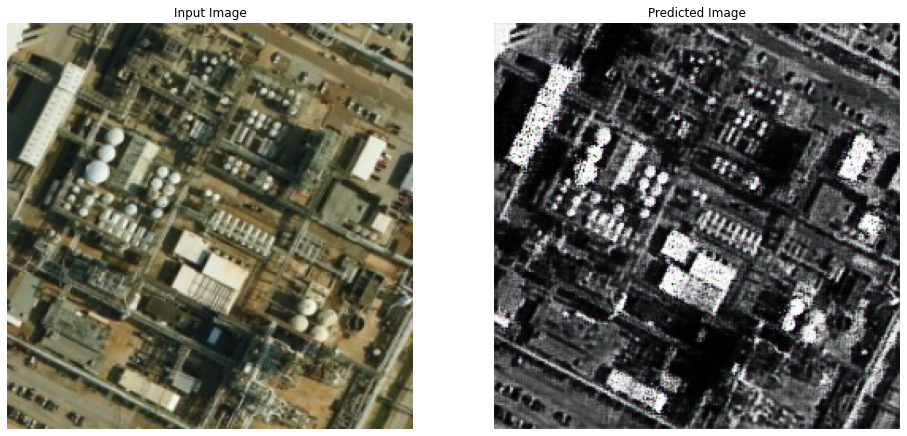

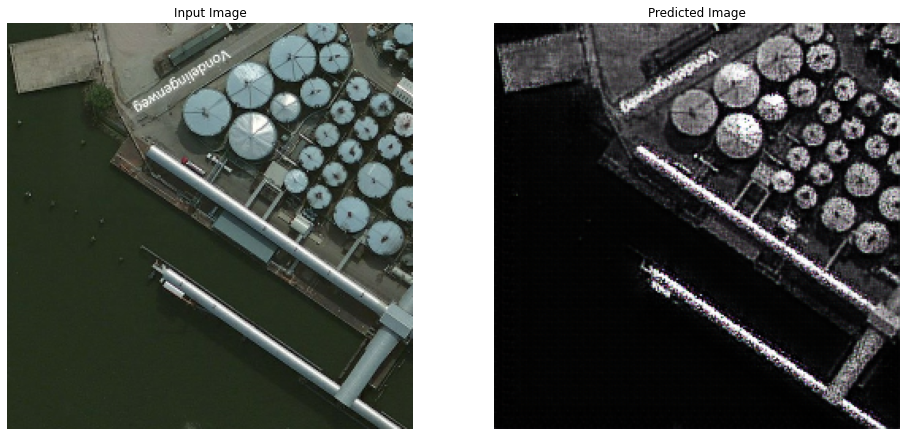

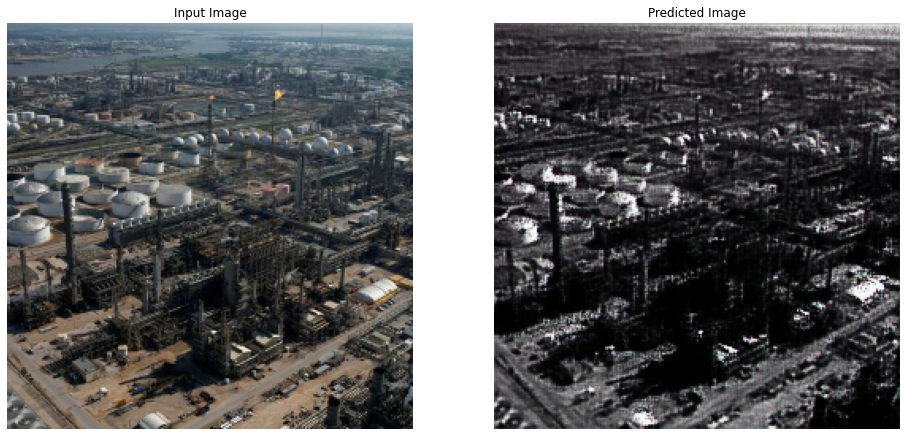

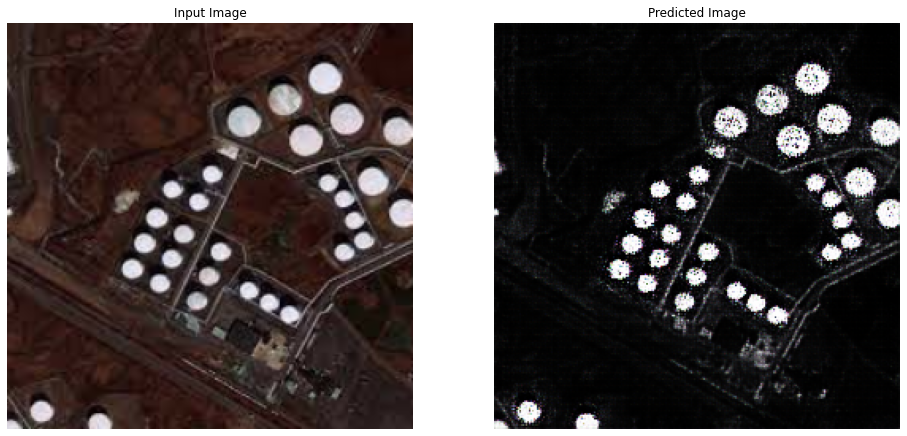

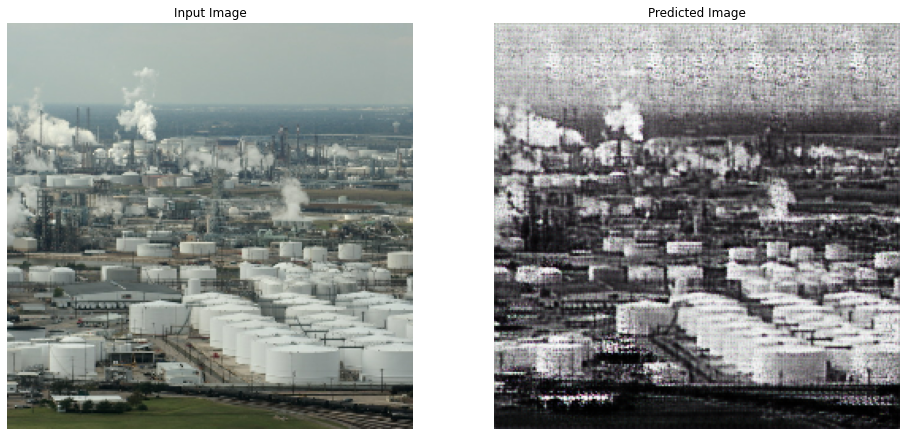

...

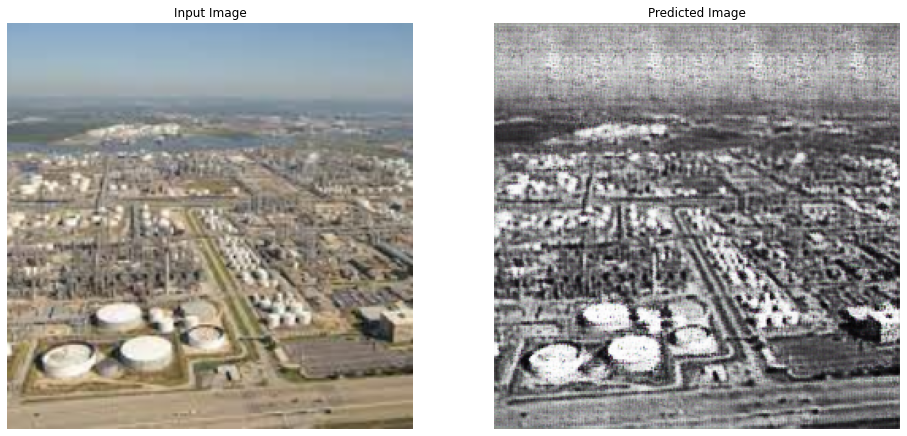

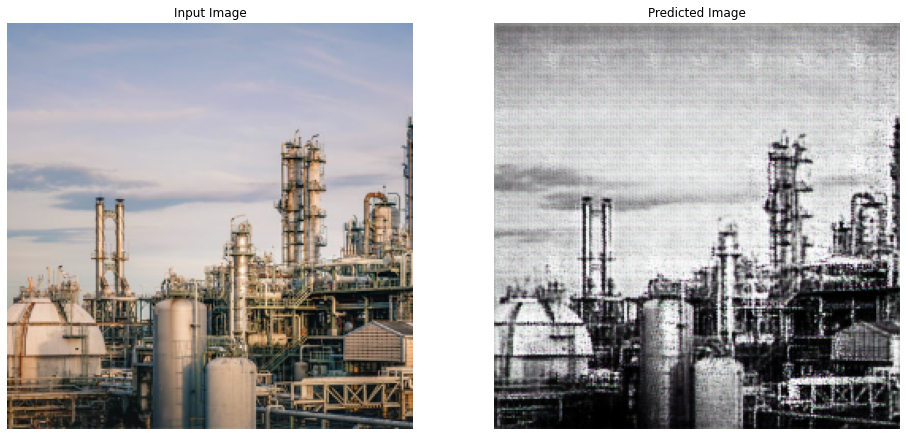

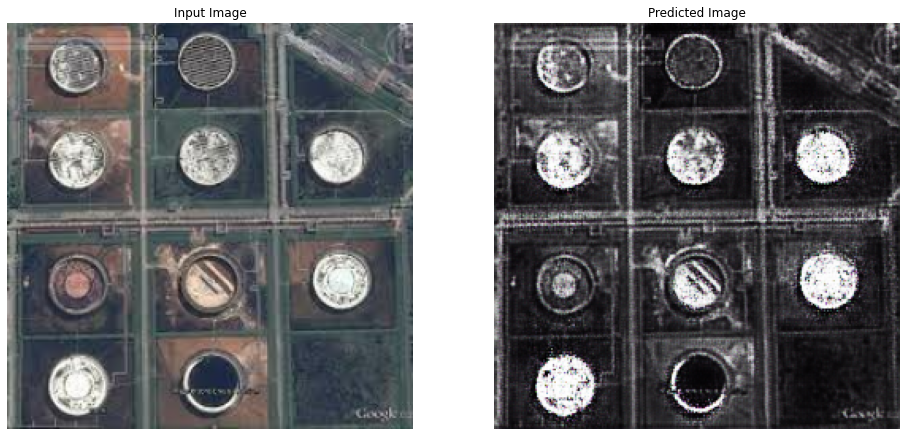

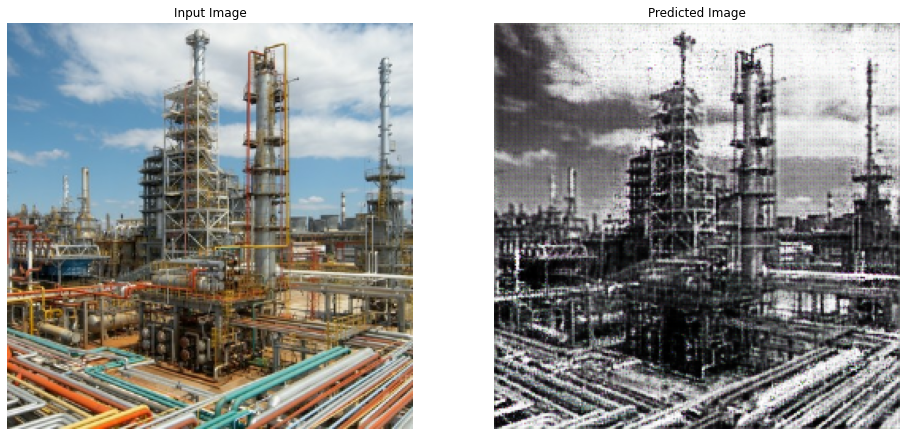

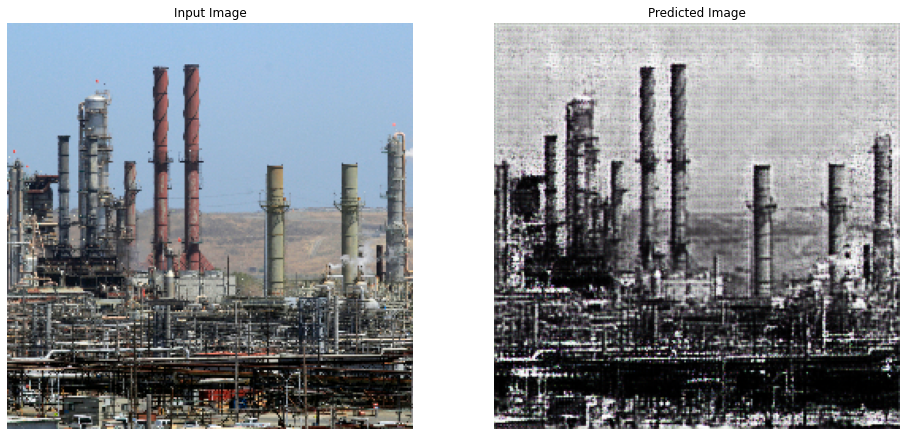

In [ ]:
import tensorflow as tf
import PIL
import os
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt

batch_size = 20
img_height = 256
img_width = 256
num_classes = 8
channels = 3
num_features = 100

def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

def preprocess_image_test(image):
  image = normalize(image)
  return image

generator_g = keras.models.load_model(input('give .h5 file '))
test_optical = tf.keras.preprocessing.image_dataset_from_directory(input('Enter Dataset path '),
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)
test_optical = test_optical.cache().map(
    preprocess_image_test, num_parallel_calls=tf.data.AUTOTUNE)

for inp in test_optical:
  prediction = generator_g(inp,training=False)
  for i in range(prediction.shape[0]):
    plt.figure(figsize=(16, 16))
    display_list = [inp[i], prediction[i]]
    title = ['Input Image', 'Predicted Image']
    for j in range(2):
      plt.subplot(1, 2, j+1)
      plt.title(title[j])
      plt.imshow((display_list[j] * 0.5 + 0.5))
      plt.axis('off')
    plt.show()

In [ ]:
test_optical = test_optical.cache().map(
    preprocess_image_test, num_parallel_calls=tf.data.AUTOTUNE)

test_sar = test_sar.cache().map(
    preprocess_image_test, num_parallel_calls=tf.data.AUTOTUNE)

(1, 256, 256, 3) (1, 256, 256, 3)


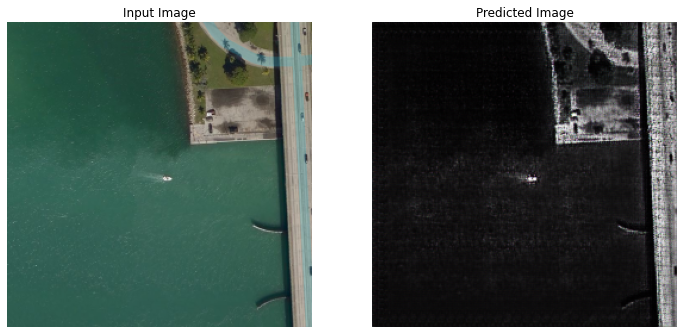

(1, 256, 256, 3) (1, 256, 256, 3)


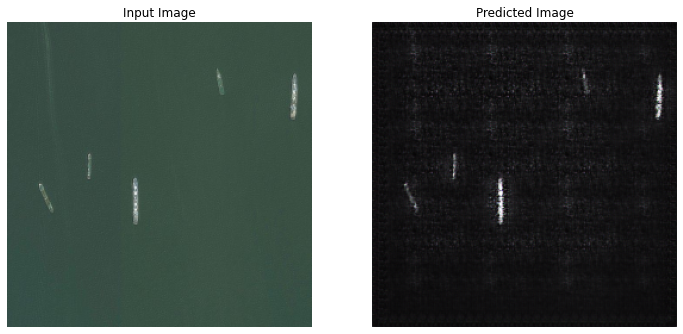

(1, 256, 256, 3) (1, 256, 256, 3)


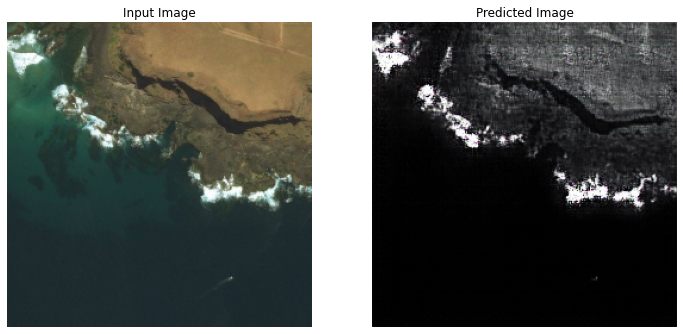

(1, 256, 256, 3) (1, 256, 256, 3)


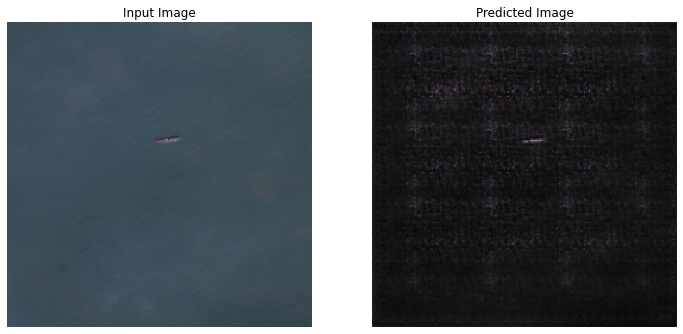

(1, 256, 256, 3) (1, 256, 256, 3)


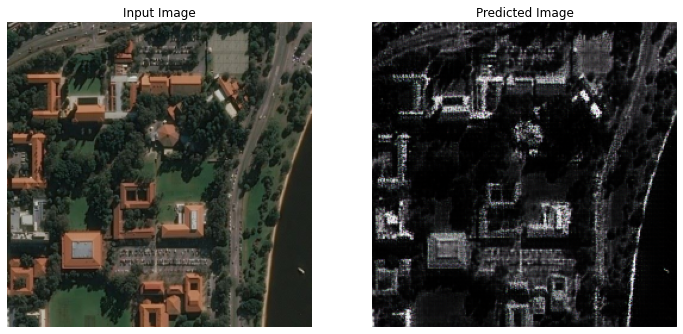

In [ ]:
for inp,i in zip(test_optical.take(5),np.arange(1,6)):
  inp = tf.reshape(inp[0],[1,256,256,3])
  prediction = generator_g(inp)

  plt.figure(figsize=(12, 12))
  print(inp.shape,prediction.shape)
  display_list = [inp[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    plt.imshow((display_list[i] * 0.5 + 0.5))
    plt.axis('off')
    plt.savefig('predictions_sar'+str(n))
  plt.show()

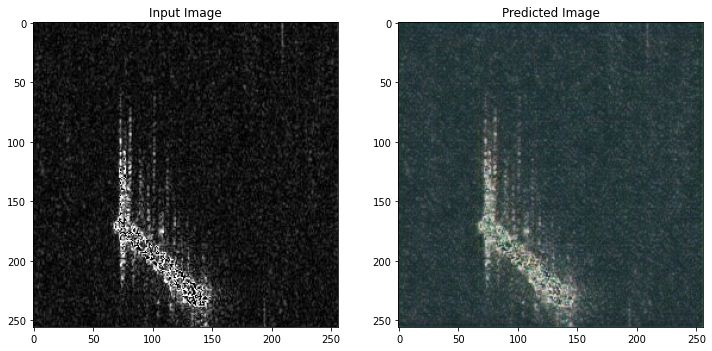

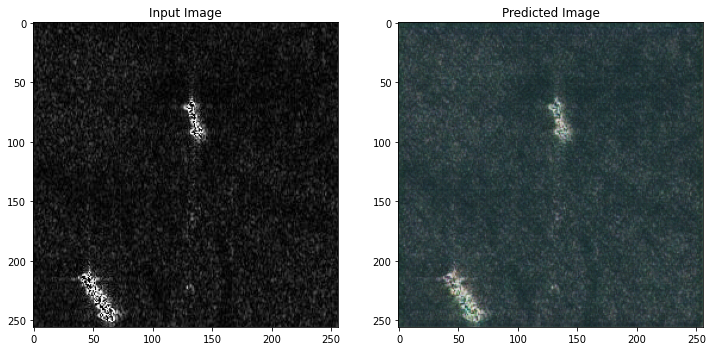

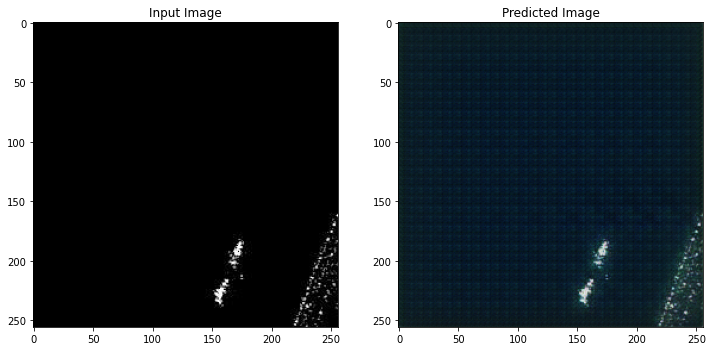

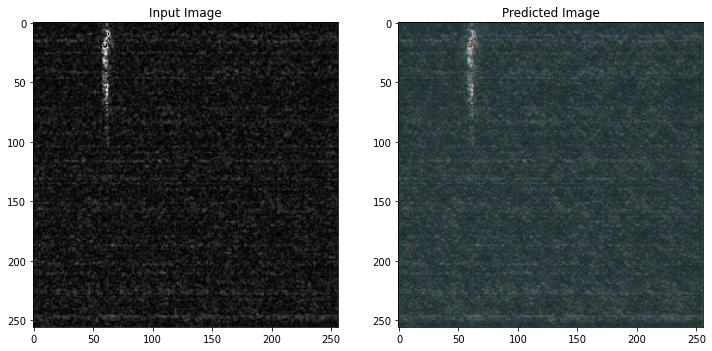

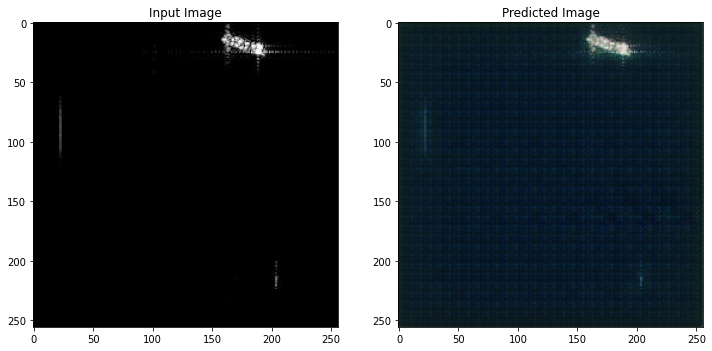

In [ ]:
for inp,i in zip(test_sar.take(5),np.arange(1,6)):
  inp = tf.reshape(inp[0],[1,256,256,3])
  prediction = generator_f(inp)
  plt.figure(figsize=(12, 12))
  display_list = [inp[0], prediction[0]]
  title = ['Input Image', 'Predicted Image']

  for i in range(2):
    plt.subplot(1, 2, i+1)
    plt.title(title[i])
    plt.imshow((display_list[i] * 0.5 + 0.5))
    plt.savefig('predictions_opt'+str(n))
  plt.show()

In [ ]:
!zip -r training_checkpoints_cyclegan_20.zip training_checkpoints

  adding: training_checkpoints/ (stored 0%)
  adding: training_checkpoints/ckpt-4.index (deflated 81%)
  adding: training_checkpoints/checkpoint (deflated 68%)
  adding: training_checkpoints/ckpt-2.index (deflated 81%)
  adding: training_checkpoints/ckpt-3.index (deflated 81%)
  adding: training_checkpoints/ckpt-4.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-1.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-3.data-00000-of-00001 (deflated 15%)
  adding: training_checkpoints/ckpt-1.index (deflated 81%)
  adding: training_checkpoints/ckpt-2.data-00000-of-00001 (deflated 15%)


In [ ]:
!cp /content/training_checkpoints_cyclegan.zip /content/drive/MyDrive/

In [ ]:
generator_f.training = False
generator_g.training = False
keras.models.save_model(generator_f,'sar_to_optical.h5')
keras.models.save_model(generator_g,'optical_to_sar.h5')

In [ ]:
!pip install osgeo

  ERROR: Failed building wheel for osgeo
  Running setup.py clean for osgeo
Failed to build osgeo
    Running setup.py install for osgeo ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-bi8v3sd_/osgeo/setup.py'"'"'; __file__='"'"'/tmp/pip-install-bi8v3sd_/osgeo/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/pip-record-74qg6p1k/install-record.txt --single-version-externally-managed --compile Check the logs for full command output.


In [ ]:
    from osgeo import gdal
    file_path="D:/work/python/Tif_to_png/a_image.tif"
    ds=gdal.Open(file_path)
    driver=gdal.GetDriverByName('PNG')
    dst_ds = driver.CreateCopy('D:/work/python/Tif_to_png/example.png', ds)
    dst_ds = None
    src_ds = None

In [1]:
!gdown --id 1NqCYn8Lubh72wcIoBgcpAh3NaAciRo33

Downloading...
From: https://drive.google.com/uc?id=1NqCYn8Lubh72wcIoBgcpAh3NaAciRo33
To: /content/pix2pix_1k.zip
514MB [00:10, 51.1MB/s]


In [2]:
!unzip pix2pix_1k.zip

Archive:  pix2pix_1k.zip
   creating: pix2pix_1k/
  inflating: pix2pix_1k/image_26.121301873126995_-80.18105971054015_0.png  
  inflating: pix2pix_1k/image_26.189293675876737_-98.23062357368438_0.png  
  inflating: pix2pix_1k/image_26.234504040689792_-98.24284079798333_0.png  
  inflating: pix2pix_1k/image_26.685430499546165_-80.15194141697496_0.png  
  inflating: pix2pix_1k/image_26.76411506473626_-80.10107042390598_0.png  
  inflating: pix2pix_1k/image_26.80917337414449_-80.0881385624556_0.png  
  inflating: pix2pix_1k/image_27.533569541040286_-99.47471584397005_0.png  
  inflating: pix2pix_1k/image_27.567287898874625_-99.51284914916427_0.png  
  inflating: pix2pix_1k/image_27.567334067381726_-99.50018660409278_0.png  
  inflating: pix2pix_1k/image_27.807458799743056_-97.42011224485988_1.png  
  inflating: pix2pix_1k/image_27.80760335597435_-97.43279822411681_1.png  
  inflating: pix2pix_1k/image_27.81945039411514_-97.48338634761834_1.png  
  inflating: pix2pix_1k/image_27.8197268280

In [3]:
!gdown --id 1neQf4daICBIh9ncr0enD49JedHTRrGeN

Downloading...
From: https://drive.google.com/uc?id=1neQf4daICBIh9ncr0enD49JedHTRrGeN
To: /content/optical_to_sar_100.h5
218MB [00:02, 83.1MB/s]


In [ ]:
!rm *.png

In [5]:
import tensorflow as tf
import PIL
import os
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
matplotlib.use('agg')
batch_size = 12
img_height = 256
img_width = 256
num_classes = 8
channels = 3
num_features = 100

def normalize(image):
  image = tf.cast(image, tf.float32)
  image = (image / 127.5) - 1
  return image

def preprocess_image_test(image):
  image = normalize(image)
  return image

generator_g = keras.models.load_model(input('give .h5 file '))
test_optical = tf.keras.preprocessing.image_dataset_from_directory(input('Enter Dataset path '),
                                                               labels=None,
                                                               image_size=(img_height, img_width),
                                                               subset='training',
                                                               validation_split= 0.99,
                                                               batch_size=batch_size,
                                                               seed=42,
                                                               smart_resize=True)
test_optical = test_optical.cache().map(
    preprocess_image_test, num_parallel_calls=tf.data.AUTOTUNE)

for i,inp in enumerate(test_optical):
  prediction = generator_g(inp,training=False)
  prediction = tf.image.resize(prediction,[512,512],preserve_aspect_ratio=True)
  for j in range(prediction.shape[0]):
    plt.figure(figsize=(10, 5))
    display_list = [inp[j], prediction[j]]
    title = ['Input Image', 'Predicted Image']
    for k in range(2):
      plt.subplot(1, 2, k+1)
      plt.title(title[k])
      plt.imshow((display_list[k] * 0.5 + 0.5))
    plt.savefig('cycleoutput\\predictions_opt'+str(i+j))
    tf.keras.preprocessing.image.save_img('cycleoutput\\pred'+str(i+j)+'.png',prediction[j].numpy(), scale=True)
    plt.close('all')

give .h5 file optical_to_sar_100.h5
Enter Dataset path pix2pix_1k
Found 865 files belonging to 1 classes.
Using 9 files for training.


In [ ]:
import os
from PIL import Image
for i in range(0,len(os.listdir('sar'))):
  img1 = Image.open('sar/pred'+str(i)+'.png')
  img2 = Image.open('optical/img'+str(i)+'.png')
  img1_size = img1.resize((256, 256))
  img2_size = img2.resize((256,256))
  img3 = Image.new("RGB", (512, 256), "white")

  img3.paste(img2_size, (0, 0))

  img3.paste(img1_size, (256, 0))
  img3.save('pix2pix_data/paired'+str(i)+'.png')

os.mkdir('pix2pix_data/train')
os.mkdir('pix2pix_data/test')
import shutil
import random
import math
l = os.listdir('pix2pix_data')
le = len(l)-2
random.shuffle(l)
p = 0.25
size = math.floor(le*(1-p))
print(size)
train = l[0:size+1]
test = l[size+1:]
for i in train:
  if i.endswith('.png'):
    shutil.move('pix2pix_data'+'/'+i,'pix2pix_data'+'/train/'+i)
for j in test:
  if j.endswith('.png'):
    shutil.move('pix2pix_data/'+j,'pix2pix_data'+'/test/'+j)

648


In [ ]:
!zip -r drive/MyDrive/pix2pix_data.zip pix2pix_data

  adding: pix2pix_data/ (stored 0%)
  adding: pix2pix_data/train/ (stored 0%)
  adding: pix2pix_data/train/paired426.png (deflated 0%)
  adding: pix2pix_data/train/paired555.png (deflated 0%)
  adding: pix2pix_data/train/paired406.png (deflated 0%)
  adding: pix2pix_data/train/paired652.png (deflated 0%)
  adding: pix2pix_data/train/paired763.png (deflated 0%)
  adding: pix2pix_data/train/paired759.png (deflated 0%)
  adding: pix2pix_data/train/paired609.png (deflated 0%)
  adding: pix2pix_data/train/paired260.png (deflated 0%)
  adding: pix2pix_data/train/paired160.png (deflated 0%)
  adding: pix2pix_data/train/paired500.png (deflated 0%)
  adding: pix2pix_data/train/paired686.png (deflated 0%)
  adding: pix2pix_data/train/paired566.png (deflated 0%)
  adding: pix2pix_data/train/paired716.png (deflated 0%)
  adding: pix2pix_data/train/paired620.png (deflated 0%)
  adding: pix2pix_data/train/paired228.png (deflated 0%)
  adding: pix2pix_data/train/paired184.png (deflated 0%)
  adding: 